In [10]:
from analysis.kalman_filter import apply_Kalman_filter_on_trial
from stimuli.motion_structure import MotionStructure
from scipy.special import logsumexp
eps = 1e-7
def estimate(x, t, glo, λ_I, σ_R=0.):
    structure = MotionStructure(glo, λ_I)
    ℓ = apply_Kalman_filter_on_trial(x, t, structure, σ_R)
    return ℓ

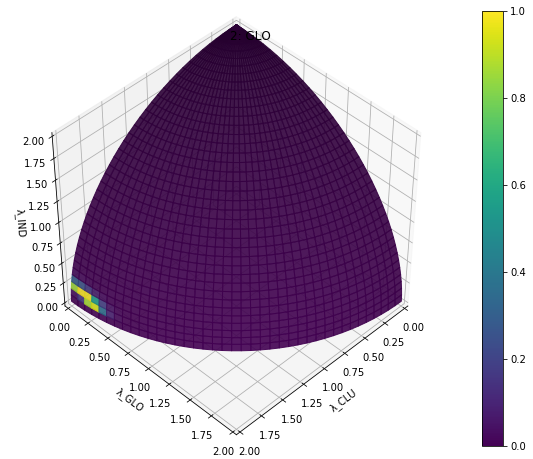

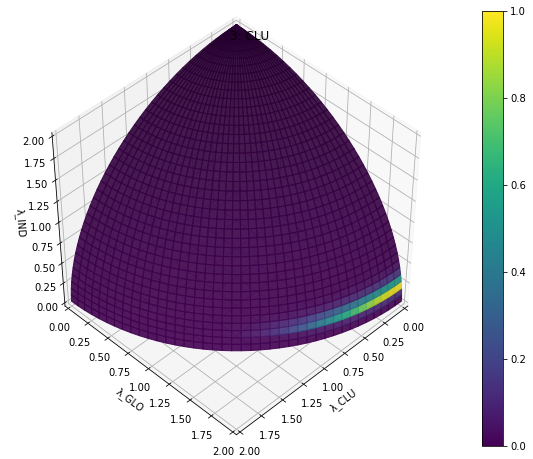

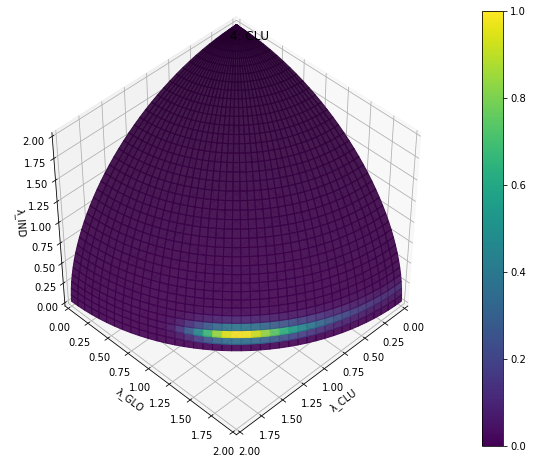

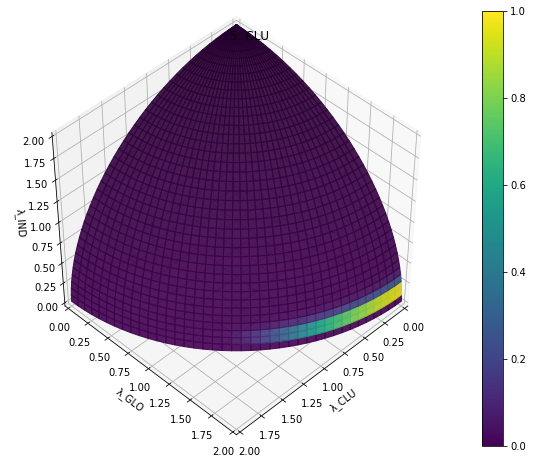

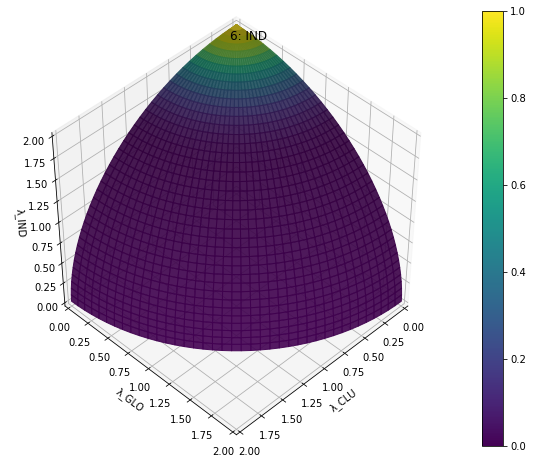

...

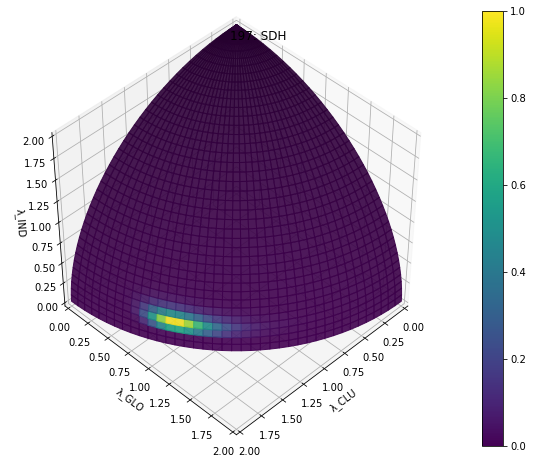

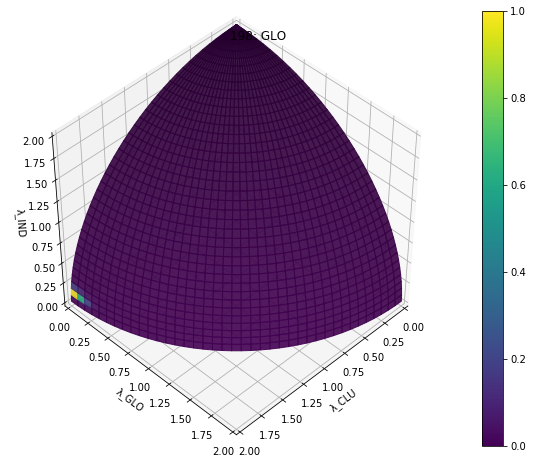

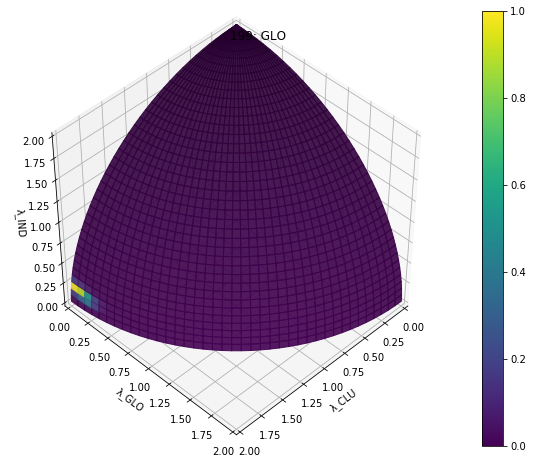

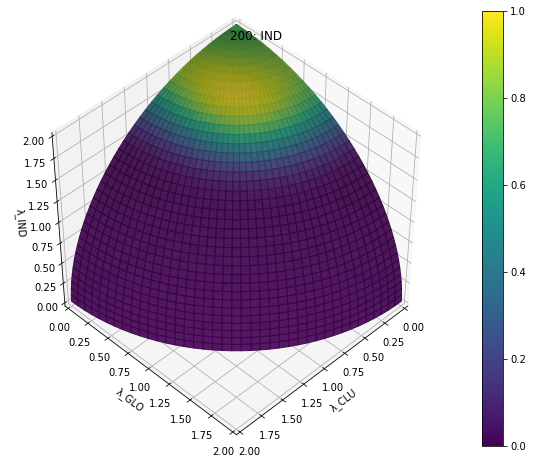

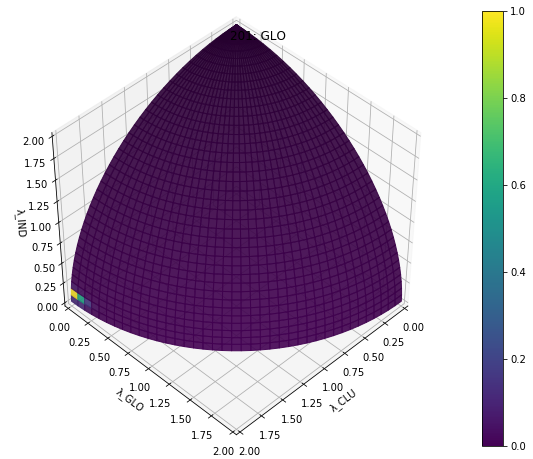

In [11]:
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from utils.data import load_data
import pickle
f = open('../data/pilot_heatmap.dat', 'wb+')
cut = 200
data = load_data('../data/sichao/pilot_sichao.dat')[:cut]
#θ inclination angle
#φ azimuthal angle
n_θ = 40 # number of values for theta
n_φ = 40 # number of values for phi
r = 2   # radius of sphere
λ_I_min = 1e-2
θ, φ = np.mgrid[0: np.pi/2 - λ_I_min: n_θ*1j, 0.: np.pi/2: n_φ*1j]
x = r * np.sin(θ) * np.cos(φ)
y = r * np.sin(θ) * np.sin(φ)
z = r * np.cos(θ)
colormap = cm.ScalarMappable(cmap=cm.viridis)
for idx in range(cut):
    trial = data[idx]
    phi, t = trial['phi'], trial['t']
    ℓ = np.zeros((n_θ, n_φ))
    for i in range(n_θ):
        for j in range(n_φ):
            λ_I = z[i, 0]
            glo = np.cos(φ[0, j]) ** 2
            # print(λ_I, glo)
            ℓ[i, j] = estimate(phi, t, glo, λ_I, σ_R=0.05)
    pickle.dump(ℓ, f)
    # normalizer = logsumexp(ℓ.flatten())
    ℓ = np.exp(ℓ - ℓ.max())
    # print(ℓ)
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.view_init(45, 45)
    ax.plot_surface(x,y,z,  rstride=1, cstride=1, facecolors=cm.viridis(ℓ/ℓ.max()), alpha=0.9, linewidth=1) 
    ax.set_xlim([0,2])
    ax.set_ylim([0,2])
    ax.set_zlim([0,2])
    ax.set_xlabel('λ_CLU')
    ax.set_ylabel('λ_GLO')
    ax.set_zlabel('λ_IND')
    ax.set_title(f"{idx+2}: {trial['answer']}")
    plt.colorbar(colormap)
    plt.show()
f.close()
